In [2]:
from matplotlib import pyplot as plt
import pandas as pd
import numpy as np
import os
import cv2 as cv
import csv
import matplotlib.patches as patches #Use to draw rectangle into image
#from numpy import genfromtxt

In [3]:
DATA_PATH = "D:\\dev\\darknet-master\\build\\darknet\\x64\\yolov3_spp\\data"
IMAGE_PATH = "D:\\dev\\darknet-master\\build\\darknet\\x64\\yolov3_spp"

In [31]:
class BoxInfo:
    
    def __init(self):
        self.classId=-1
        self.cx=-1
        self.cy=-1
        self.w=-1
        self.h=-1
        
class ImageInformation:
    global IMAGE_PATH,DATA_PATH
    COLOR = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, 10)]
    def __init__(self,name):
        #Read image for showing
        self.strImageName = name
        FolderName = "_".join(name.split("_")[:-1])
        self.folderName = IMAGE_PATH+"\\"+FolderName
        self.cvImage = cv.imread(self.folderName+"\\"+name)
        #Read bounding box
        self.ReadBoundingBox()
        self.FeatureMapDict=dict()
        
    def ReadBoundingBox(self):
        self.BoxList=[]
        strBoundingBoxFileName = self.strImageName.replace("jpg","txt")
        strBBFileFullPath = self.folderName+"\\"+strBoundingBoxFileName
        with open(strBBFileFullPath) as f_in:
            lines = f_in.readlines()
            for line in lines:
                tokens = line.split(" ")
                if len(tokens)>4:
                    newBox=BoxInfo()
                    for eleIndex in range(len(tokens)):
                        if eleIndex == 0:
                            #class ID
                            newBox.classId = int(tokens[eleIndex])
                        elif eleIndex ==1:
                            #Cx
                            newBox.cx = int(float(tokens[eleIndex])*640)
                        elif eleIndex == 2:
                            #Cy
                            newBox.cy = int(float(tokens[eleIndex])*480)
                        elif eleIndex == 3:
                            newBox.w = int(float(tokens[eleIndex])*640)
                        elif eleIndex == 4:
                            newBox.h = int(float(tokens[eleIndex])*480)
                    if newBox.classId >-1 and newBox.cx>-1 and newBox.cy>-1 and newBox.w>-1 and newBox.h>-1:
                        self.BoxList.append(newBox)
                    else:
                        print("Box(class,x,y,w,h):",newBox.classId,newBox.cx,newBox.cy,newBox.w,newBox.h,
                              " got problem in file ",strBBFileFullPath)
                else:
                    print("Cannot read line ",line," in bounding box file ",strBBFileFullPath)
    def ReadFeatureData(self,LayerIdx):
        self.FeatureMapDict[LayerIdx]=[]
        layerName = "Layer{:04d}".format(LayerIdx)
        DataFolder = DATA_PATH+"\\"+self.strImageName.replace(".jpg","")
        for file in os.listdir(DataFolder):
            if layerName in file:
                #print("Found filter file ", file)
                featurefileName = DataFolder+"\\"+file
                self.FeatureMapDict[LayerIdx].append(pd.read_csv(featurefileName,header=None))
        #self.ShowFeatureMap(LayerIdx)        
    def ShowFeatureMap(self,LayerIdx=5):
        """Show feature heat map"""
        self.figureList=[]
        self.axList=[]
        #for iLayerIdx in self.FeatureMapDict:
        for iFilterIdx in range(len(self.FeatureMapDict[LayerIdx])):
            #fig = plt.figure()
            #ax = plt.axes()
            #########Configuration#########################
            fig,ax=plt.subplots()
 
            ################################################
            ax.pcolor(self.FeatureMapDict[LayerIdx][iFilterIdx])
            #plt.yticks(np.arange(0.5, len(Data_List[iFilterIdx].index), 1), Data_List[iFilterIdx].index)
            #plt.xticks(np.arange(0.5, len(Data_List[iFilterIdx].columns), 1), Data_List[iFilterIdx].columns)
            plt.title("Layer{:04d}-Filter{:04d}".format(LayerIdx,iFilterIdx))
            #plt.show()
            
            ##############Configuration#######################
            ax.set_ylim(ax.get_ylim()[::-1])        # invert the axis
            ax.xaxis.tick_top()                     # and move the X-Axis
            ax.yaxis.tick_left()                    # remove right y-Ticks
            ####################################################
            self.figureList.append(fig)
            self.axList.append(ax)
        self.ShowBoxOverFeatureMap(LayerIdx)
    def ShowBoxOverFeatureMap(self,LayerIdx):
        self.FeatureHeight,self.FeatureWidth = self.FeatureMapDict[LayerIdx][0].shape
        print("Feature map size:",self.FeatureMapDict[LayerIdx][0].shape,";Center size:",self.CenterWSize,self.CenterHSize)
        for figure,ax in zip(self.figureList,self.axList):
            for Box in self.BoxList:
                #Convert cx,cy,w,h to x,y,w,h before draw data into feature map figure
                w= Box.w*self.FeatureWidth/640
                h =Box.h*self.FeatureHeight/480
                x = Box.cx*self.FeatureWidth/640 - w/2
                y = Box.cy*self.FeatureHeight/480 - h/2
                #drawing box into feature each figure map and show it
                
                rect = patches.Rectangle((x,y),w,h,linewidth=2,edgecolor=(0.5,0.5,0.5),fill=False)
                #print("rect to add(x,y,w,h)",x,y,w,h)
                ax.add_patch(rect)
                self.FeatureHeight,self.FeatureWidth = self.FeatureMapDict[LayerIdx][0].shape
                cx = int(Box.cx*self.FeatureWidth/640)
                cy = int(Box.cy*self.FeatureHeight/480)
                for centerW in range(-int(self.CenterWSize/2),int(self.CenterWSize/2)+1):
                    for centerH in range(-int(self.CenterHSize/2),int(self.CenterHSize/2)+1):
                        circle = plt.Circle((cx+centerW, cy+centerH), 0.2, color='r')
                        
                        ax.add_patch(circle)
            #plt.show()
                #time.sleep(5)
                #figure.close()
        plt.show()
        plt.close('all')
    def GetCenterFeatureCell(self,Box,LayerIdx):
        """if input box, we get the center feature cell that contain that box"""
        self.FeatureHeight,self.FeatureWidth = self.FeatureMapDict[LayerIdx][0].shape
        #Since the center size is always even number, it is not good, so we add 1 to make it odd number
        self.CenterWSize = int(self.FeatureWidth/(640/(2**4)))+1
        self.CenterHSize = int(self.FeatureHeight/(480/(2**4)))+1
        w = Box.w*self.FeatureWidth/640
        h = Box.h*self.FeatureHeight/480
        cx = int(Box.cx*self.FeatureWidth/640)
        cy = int(Box.cy*self.FeatureHeight/480)
        result = []
        for FilterIdx in range(len(self.FeatureMapDict[LayerIdx])):
            result.append(self.FeatureMapDict[LayerIdx][FilterIdx].loc[cy-int(self.CenterHSize/2):cy+int(self.CenterHSize/2),cx-int(self.CenterWSize/2):cx+int(self.CenterWSize/2)])
        #print("Shape before convert ",result[0].shape)
        #print("Data before change axis:")
        #print(result[0],end=",")
        #print("\nData after change axis")
        npDiffArray = np.array(result)
        #print(npDiffArray[0])
        #print("[i].Shape of center cells:",npDiffArray.shape)
        npDiffArray = np.swapaxes(np.array(result),0,2)
        #print("[i].Shape of center cells after swap axes:",npDiffArray.shape)
        return npDiffArray
    def GetBoxFeature(self,Box,LayerIdx):
        """Get tensor features of specific layer """
        self.FeatureHeight,self.FeatureWidth = self.FeatureMapDict[LayerIdx][0].shape
        w = int(Box.w*self.FeatureWidth/640)
        h = int(Box.h*self.FeatureHeight/480)
        x = int(Box.cx*self.FeatureWidth/640)-int(w/2)
        y = int(Box.cy*self.FeatureHeight/480)-int(h/2)
        result = []
        for FilterIdx in range(len(self.FeatureMapDict[LayerIdx])):
            result.append(self.FeatureMapDict[LayerIdx][FilterIdx].loc[y:y+h,x:x+w])
        #print("Shape of result(w,h,c):",result[0].shape[1],result[0].shape[0],len(result))
        return np.reshape(result,(result[0].shape[1],result[0].shape[0],len(result)))
    def ShowImage(self):
        """Show Image"""
        #plt.imshow(self.cvImage)
        cvShowImg = self.cvImage.copy()
        for Box in self.BoxList:
            #Convert cx,cy,w,h to x,y,w,h before draw data into feature map figure
            w= int(Box.w)
            h =int(Box.h)
            x = int(Box.cx - w/2)
            y = int(Box.cy - h/2)
            #drawing box into feature each figure map and show it
            startPt = (x,y)
            endPt = (x+w,y+h)
            color = (255,255,255)
            cvShowImg = cv.rectangle(cvShowImg,startPt,endPt,color,3)
        cv.imshow(self.strImageName, cvShowImg)
        cv.waitKey(0)
    def Shape(self,LayerIdx):
        """Return Height,Witdh,channels of layer index """
        return self.FeatureMapDict[LayerIdx][0].shape[0],self.FeatureMapDict[LayerIdx][0].shape[1],len(self.FeatureMapDict[LayerIdx])
        
        
        
        
        
        

In [32]:
m_ImageInformation=ImageInformation("B44_20210126_0800_001322.jpg")

In [30]:
###Debug###
#m_ImageInformation.ReadFeatureData(LAYER_INDEX)
#m_ImageInformation.GetCenterFeatureCell(m_ImageInformation.BoxList[0],LAYER_INDEX)

Shape before convert  (3, 3)
Data before change axis:
        72      73      74
30 -0.1029 -0.1356 -0.1164
31 -0.0041 -0.0485 -0.0253
32  2.4026  2.8382  2.5042,
Data after change axis
[[-0.1029 -0.1356 -0.1164]
 [-0.0041 -0.0485 -0.0253]
 [ 2.4026  2.8382  2.5042]]


array([[[-1.0290e-01, -8.8000e-03, -7.7000e-02, ..., -1.5000e-03,
         -4.1000e-02, -7.6000e-03],
        [-4.1000e-03, -9.2000e-03, -7.7200e-02, ..., -1.5000e-03,
         -3.9900e-02, -3.9700e-02],
        [ 2.4026e+00,  9.0800e-02,  2.5500e-02, ..., -1.6000e-03,
         -1.2400e-02,  5.1200e-01]],

       [[-1.3560e-01, -1.8200e-02, -1.3100e-01, ..., -1.5000e-03,
         -7.0600e-02, -3.1000e-02],
        [-4.8500e-02, -1.1300e-02, -1.2290e-01, ..., -1.5000e-03,
         -6.4700e-02, -7.0400e-02],
        [ 2.8382e+00,  7.2500e-02,  2.8330e-01, ..., -1.6000e-03,
         -1.8700e-02,  6.1140e-01]],

       [[-1.1640e-01, -1.8300e-02, -1.3060e-01, ..., -1.5000e-03,
         -5.5600e-02, -3.7000e-02],
        [-2.5300e-02, -9.9000e-03, -1.1540e-01, ..., -1.5000e-03,
         -4.8400e-02, -7.2100e-02],
        [ 2.5042e+00,  7.0100e-02,  5.9240e-01, ..., -1.6000e-03,
         -5.2000e-03,  5.2590e-01]]])

# Show 256 feature map of layer 111 in camera B44

<ipython-input-31-7d199beac502>:73: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots()


Feature map size: (60, 80) ;Center size: 3 3


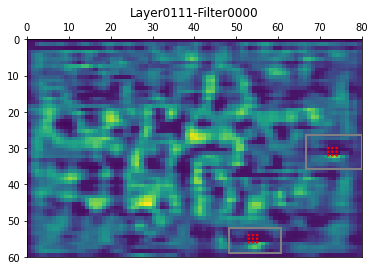

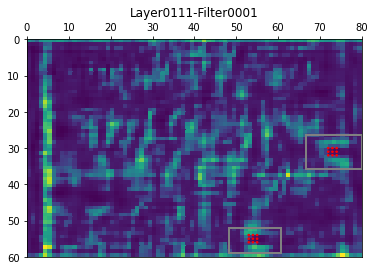

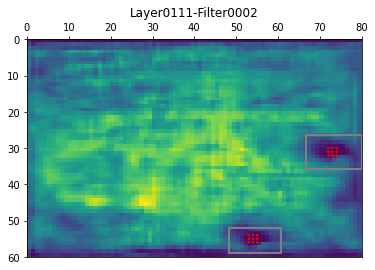

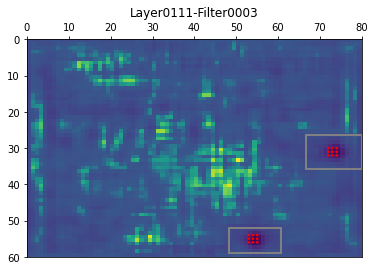

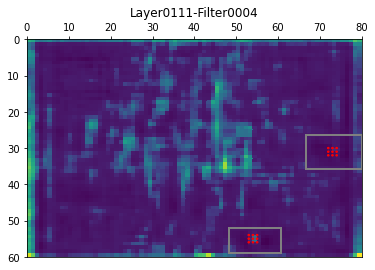

...

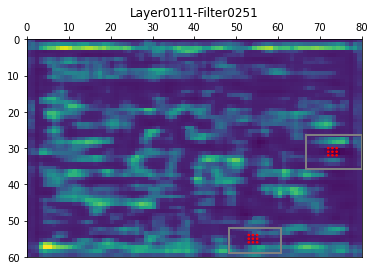

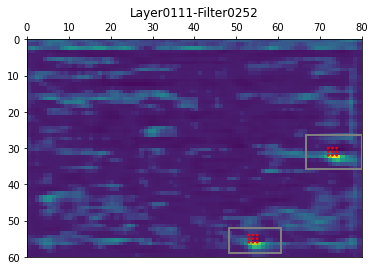

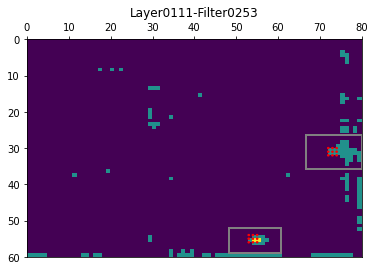

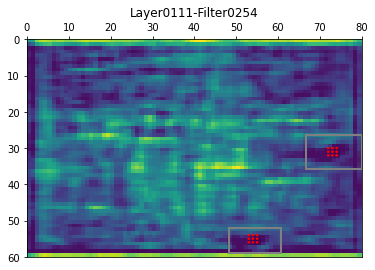

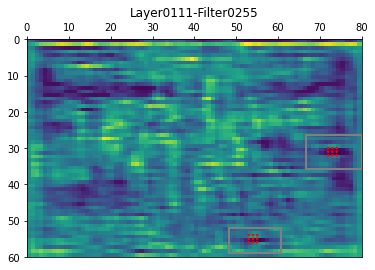

In [33]:
LAYER_INDEX=111
m_ImageInformation.ReadFeatureData(LAYER_INDEX)
m_ImageInformation.GetCenterFeatureCell(m_ImageInformation.BoxList[0],LAYER_INDEX)
#m_ImageInformation.GetBoxFeature(m_ImageInformation.BoxList[0],LAYER_INDEX)
m_ImageInformation.ShowImage()
m_ImageInformation.ShowFeatureMap(LAYER_INDEX)

In [34]:
#LAYER=5
#LAYER=59
#LAYER=60
LAYER=111
class FindPersistanceFeature:
    def __init__(self):
        pass
    def TestIndex(self,index_list,index_type="Min index"):
        """Calculate and print sum error of feature for testing list of interesting index"""
        for ImageInfoIdxPre in range(0,len(self.ImageInformation)-1):
            print(
              "[i].Center feature error between frame {:d} and frame {:d} consecutive frame using {}:".format(
                  self.FrameRange[0]+ImageInfoIdxPre,self.FrameRange[0]+ImageInfoIdxPre+1,
                index_type),
              np.sum(np.abs(self.CenterFeatureDistError.loc[ImageInfoIdxPre,index_list])))
        
    def Run(self,FrameRange,strCarName="B44_20210126_0800_00"):
        #self.strCarName="B44_20210126_0800_00"
        self.strCarName=strCarName
        self.ImageInformation = []
        self.FrameRange=FrameRange
        for ImageIdx in range(FrameRange[0],FrameRange[1]):
            fullCarName = self.strCarName+str(ImageIdx)+".jpg"
            newCar = ImageInformation(fullCarName)
            newCar.ReadFeatureData(LAYER)
            self.ImageInformation.append(newCar)
        DeltaFeatureList=[]
        for ImageInfoIdxPre in range(0,len(self.ImageInformation)-1):
            DeltaFeature = self.ImageInformation[ImageInfoIdxPre+1].GetCenterFeatureCell(
                self.ImageInformation[ImageInfoIdxPre+1].BoxList[0],LAYER)-\
            self.ImageInformation[ImageInfoIdxPre].GetCenterFeatureCell(
                self.ImageInformation[ImageInfoIdxPre].BoxList[0],LAYER)
            if len(DeltaFeature.shape)==3:
                print("Feature size:",DeltaFeature.shape)
                DeltaFeature = np.sum(np.abs(DeltaFeature),axis=(0,1))
                print("Feature size after combine:",DeltaFeature.shape)
            #print("After sum, size of different matrix:",DeltaFeature.shape)
            DeltaFeatureList.append(DeltaFeature)
            #print("Total center feature error between 2 consecutive frame:",np.sum(np.abs(DeltaFeature)))
        self.CenterFeatureDistError = pd.DataFrame(DeltaFeatureList)
        self.FindKSmallestPersistanceCenterFeature()
        for ImageInfoIdxPre in range(0,len(self.ImageInformation)-1):
            print(
              "[i].Smallest center feature error between frame {:d} and frame {:d} consecutive frame:".format(
                  FrameRange[0]+ImageInfoIdxPre,FrameRange[0]+ImageInfoIdxPre+1),
              np.sum(np.abs(self.SmallestFeature.loc[ImageInfoIdxPre,:])))
    def FindKSmallestPersistanceCenterFeature(self,kSmallestFeatrure=-1):
        """Since if we use all feature, it is not good for distinguish 2 frame, we try to find only persistance 
        feature by filter some features that have small changing over frames. 
        store the feature index into a list to use later"""
        k=0
        self.SmallestFeatureIdx=[]
        self.SmallestFeature=[]
        if kSmallestFeatrure==-1:
            k = int(self.CenterFeatureDistError.shape[1]/2)
            #print("Number of Smallest feature will be chosen:", k)
        else:
            k = kSmallestFeatrure
            #print("Number of Smallest feature will be chosen:", k)
        DistErrorListOfFeature=[]
        for columnIdx in self.CenterFeatureDistError.columns:
            sumError=self.CenterFeatureDistError.loc[:,columnIdx].abs().sum()
            DistErrorListOfFeature.append(sumError)
        self.SmallestFeatureIdx=np.argsort(np.array(DistErrorListOfFeature))[:k]
        #self.SmallestFeatureIdx = np.sort(self.SmallestFeatureIdx)
        print("[i].Smallest Feature idx,cnt {:d}:".format(len(self.SmallestFeatureIdx)))
        for SmallestIdx in self.SmallestFeatureIdx:
            print(SmallestIdx,end=",")
        self.SmallestFeature = self.CenterFeatureDistError.iloc[:,self.SmallestFeatureIdx]
    def Run_2(self):
        """Calculate the different between 2 box feature"""
        self.strCarName="B44_20210126_0800_00"
        self.ImageInformation = []
        self.BoxFeatureErrorList=[]
        for ImageIdx in range(1322,1334):
            fullCarName = self.strCarName+str(ImageIdx)+".jpg"
            newCar = ImageInformation(fullCarName)
            newCar.ReadFeatureData(LAYER)
            self.ImageInformation.append(newCar)
        DeltaFeatureList=[]
        for ImageInfoIdxPre in range(0,len(self.ImageInformation)-1):
            Boxfeature1=self.ImageInformation[ImageInfoIdxPre].GetBoxFeature(self.ImageInformation[ImageInfoIdxPre].BoxList[0],LAYER)
            Boxfeature2=self.ImageInformation[ImageInfoIdxPre+1].GetBoxFeature(self.ImageInformation[ImageInfoIdxPre+1].BoxList[0],LAYER)
            BoxH1,BoxW1,_=Boxfeature1.shape
            BoxH2,BoxW2,_=Boxfeature2.shape
            print("Box1(w,h):",BoxW1,BoxH1,";Box2(w,h):",BoxW2,BoxH2)
            MinBoxWidth = 0
            MinBoxHeight = 0
            if BoxH1>BoxH2: MinBoxHeight = BoxH2
            else: MinBoxHeight = BoxH1
            if BoxW1>BoxW2: MinBoxWidth = BoxW2
            else: MinBoxWidth = BoxW1
            print("Min Width:",MinBoxWidth,"Min Height:",MinBoxHeight)
            y1 = int(BoxH1/2-  MinBoxHeight/2)
            x1 = int(BoxW1/2 - MinBoxWidth/2)
            y2 = int(BoxH2/2 - MinBoxHeight/2)
            x2 = int(BoxW2/2 - MinBoxWidth/2)
            MinboxFeature1 = Boxfeature1[y1:y1+MinBoxHeight,x1:x1+MinBoxWidth,:]
            MinboxFeature2 = Boxfeature2[y2:y2+MinBoxHeight,x2:x2+MinBoxWidth,:]
            print("Coordinate of box 1(x,y,w,h)",x1,y1,x1+MinBoxWidth,y1+MinBoxHeight )
            print("Coordinate of box 2(x,y,w,h)",x2,y2,x2+MinBoxWidth,y2+MinBoxHeight )
            print("Min box 1 shape:",MinboxFeature1.shape,"Min box 2 shape:",MinboxFeature2.shape )
            DeltaFeature = MinboxFeature2-MinboxFeature1
            print("Average box(h,w,c):",DeltaFeature.shape,
                  ";feature error between 2 consecutive frame:",np.average(np.abs(DeltaFeature)))
            self.BoxFeatureErrorList.append(DeltaFeature)
        
            
            
            
        
        

In [35]:
#Create object to find min intra index
m_FindPersistanceFeature = FindPersistanceFeature()

# Experiment 1.Find min intra index using ground truths

In [36]:
#Find min intra index using groundtruth
car_list = [[1322,1332],[2065,2078],[2460,2475],[2843,2868],[3226,3238],
            [3617,3625],[3986,4000]]
intra_MinIndexList=[]
for cars in car_list:
    m_FindPersistanceFeature.Run(cars)
    intra_MinIndexList.append(m_FindPersistanceFeature.SmallestFeatureIdx)

Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
[i].Smallest Feature idx,cnt 128:
147,40,144,220,213,253,166,25,119,101,224,103,128,60,22,121,115,10,159,78,63,120,214,79,14,218,210,47,70,36,123,43,90,203,31,146,172,20,228,1,242,175,200,3,236,180,66,132,206,4,64,56,129,62,82,171,222,162,33,235,243,238,86,44,68,114,107,24,117,134,77,73,145,202,160,211,232,155,88,199,183,28,83,112,11,74,80,21,133,169,221,240,42,35,130,182,241,32,245,131,254,109,226,198,176,149,197,27,71,110,167,8,248,5,168,91,201,

Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
[i].Smallest Feature idx,cnt 128:
147,166,144,220,40,213,119,253,224,101,25,103,128,121,60,115,22,159,10,78,63,120,214,79,14,218,47,70,210,36,123,31,172,90,200,203,43,20,228,243,175,129,29,3,132,222,1,64,180,146,44,33,171,56,242,236,21,66,134,4,117,238,18,155,206,211,160,202,235,232,28,11,221,77,73,161,114,255,62,86,88,112,107,82,162,240,217,199,145,83,133,80,32,197,74,81,183,156,231,226,5,48,24,94,71,190,185,252,151,148,248,136,181,42,169,150,89,254,230,198,27,143,8,68,179,26,229,45,[i].Smallest center feature error between frame 2843 and frame 2844 consecutive frame: 68.9755
[i].Smallest center feature error between frame 2844 and frame 2845 consecutive frame: 85.44480000000001
[i].Smallest center feature error between frame 2845 and frame 2846 consecutive frame: 68.43639999999999
[i].Smallest center fea

# Find min intra indexes

In [39]:
#Combine all groundtruths to have intra index
intra_MinIndexList_TopK = np.array(intra_MinIndexList)
print(intra_MinIndexList_TopK)
_,_,LayerChannel = m_FindPersistanceFeature.ImageInformation[0].Shape(LAYER)

intra_MinIndex=[]
for iFilterIdx in range(LayerChannel):
    bFound = True
    for CarIdx in range(len(intra_MinIndexList_TopK)):
        bMatch=False
        for index in intra_MinIndexList_TopK[CarIdx]:
            if index == iFilterIdx:
                bMatch = True
                break
        if not bMatch:
            bFound = False
            break
    if bFound:
        intra_MinIndex.append(iFilterIdx)

print("[i].Min features index,cnt[{:d}]:".format(len(intra_MinIndex)),intra_MinIndex)

m_FindPersistanceFeature.TestIndex(intra_MinIndex)
    

[[147  40 144 220 213 253 166  25 119 101 224 103 128  60  22 121 115  10
  159  78  63 120 214  79  14 218 210  47  70  36 123  43  90 203  31 146
  172  20 228   1 242 175 200   3 236 180  66 132 206   4  64  56 129  62
   82 171 222 162  33 235 243 238  86  44  68 114 107  24 117 134  77  73
  145 202 160 211 232 155  88 199 183  28  83 112  11  74  80  21 133 169
  221 240  42  35 130 182 241  32 245 131 254 109 226 198 176 149 197  27
   71 110 167   8 248   5 168  91 201 143 215  26 185 252 127  52 179 148
  212 181]
 [147 144 220  40 119 166 213 253 101  25 224 103 128 121  60  22 115 159
   10  78  63 120 214  79  14 218  47 210  70  36 123  31 203  43 172  90
    1 206 129 146 228 175  20  21 243 132 200  64  29   4  66 171 222 236
   33   3 180  56 117  44 134 242 155 107 238 160 161  81 232  82  77  68
   28 255 162  24  62 235 217 231  18  73 202  86 145 221 114  11  88 240
  199  80 112 211 248 169  83 201  74  32  42 252 197 149 156 136 191 100
  185  71  48  52 133   8 1

In [ ]:
#Just for debug
m_FindPersistanceFeature.CenterFeatureDistError.head(10)

# Show 256 features maps of layer 111 in network which is testing max outra indexes layer in camera D35

<ipython-input-31-7d199beac502>:73: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots()


Feature map size: (60, 80) ;Center size: 3 3


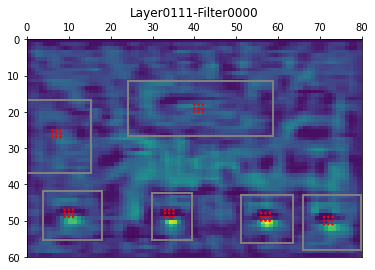

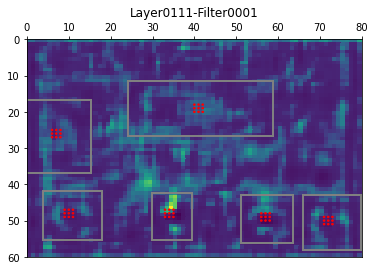

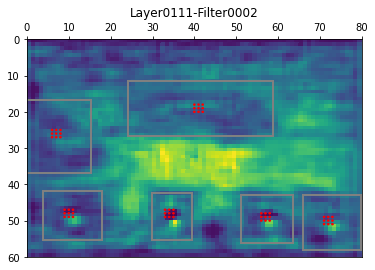

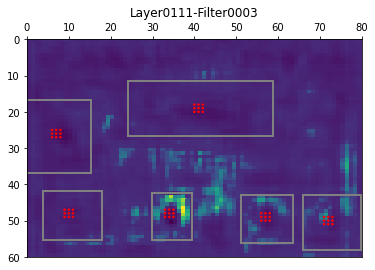

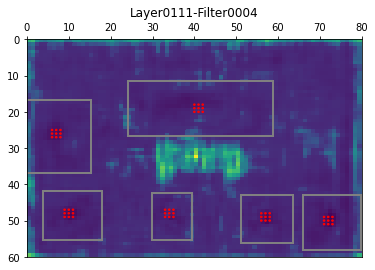

...

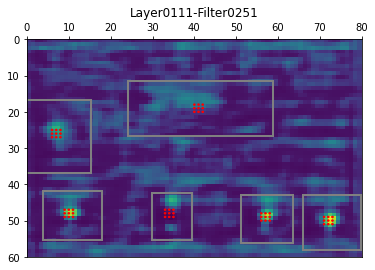

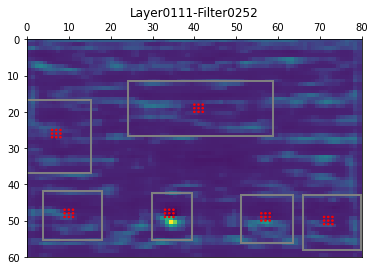

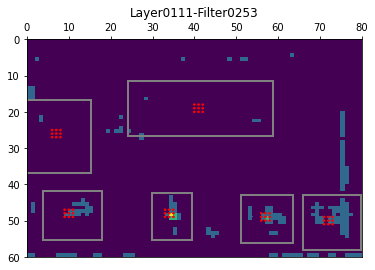

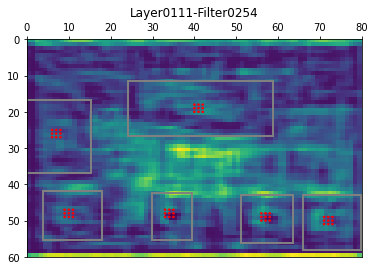

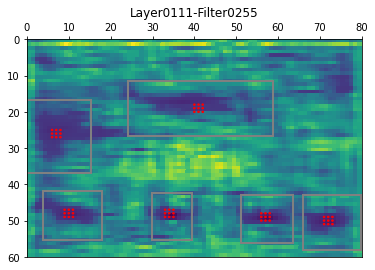

In [40]:
m_ImageInformation2=ImageInformation("D35_20210304_005679.jpg")
m_ImageInformation2.ReadFeatureData(LAYER_INDEX)
m_ImageInformation2.GetCenterFeatureCell(m_ImageInformation2.BoxList[0],LAYER_INDEX)
#m_ImageInformation.GetBoxFeature(m_ImageInformation.BoxList[0],LAYER_INDEX)
m_ImageInformation2.ShowImage()
m_ImageInformation2.ShowFeatureMap(LAYER_INDEX)

In [129]:
class CompareFeatureBetween2Cars:
    def __init__(self):
        self.LargestFeatureIdx=[]
        self.LargestFeature=[]
        self.ImageInformation=[]
        self.CenterFeatureDistErrorList=[]
    def GetCenterFeatureError_2Frames(self,FrameList=[]):
        self.ImageInformation=[]
        if len(FrameList)==0:
            self.strCarNameList=["B44_20210126_0800_002066.jpg"        
        ,"B44_20210126_0800_001323.jpg"]
        else:
            self.strCarNameList=FrameList
        for strCarName in self.strCarNameList:
            newCar = ImageInformation(strCarName)
            newCar.ReadFeatureData(LAYER)
            self.ImageInformation.append(newCar)
        DeltaFeatureList=[]
        for ImageInfoIdxPre in range(0,len(self.ImageInformation)-1):
            DeltaFeature = self.ImageInformation[ImageInfoIdxPre+1].GetCenterFeatureCell(
                self.ImageInformation[ImageInfoIdxPre+1].BoxList[0],LAYER)-\
            self.ImageInformation[ImageInfoIdxPre].GetCenterFeatureCell(
                self.ImageInformation[ImageInfoIdxPre].BoxList[0],LAYER)
            if len(DeltaFeature.shape)==3:
                DeltaFeature = np.sum(np.abs(DeltaFeature),axis=(0,1))
            DeltaFeatureList.append(DeltaFeature)
        self.CenterFeatureDistError = pd.DataFrame(DeltaFeatureList)
        self.CenterFeatureDistErrorList.append(self.CenterFeatureDistError)
        self.CenterFeatureDistErrorList.append(self.CenterFeatureDistError)
        #return np.array(DeltaFeatureList)
    def Run_Multiple_Camera(self,FrameList1=[],carPreName1 = "",FrameList2=[],carPreName2=""):
        """If 1 car appears in multiple cameras, we wish to compare the appearance of that camera, so we do here"""
        minFrameNum = 0
        self.PreName=carPreName1
        self.PreName2=carPreName2
        self.FrameRange = FrameList1
        self.FrameRange2 = FrameList2
        len1 = FrameList1[1]-FrameList1[0]
        len2 = FrameList2[1]-FrameList2[0]
        
        if len1<len2:
            minFrameNum = len1
        else: minFrameNum = len2
        for iCarFrame in range(minFrameNum):
            iCarFrame1 = FrameList1[0]+iCarFrame
            fullCarName1 = carPreName1+str(iCarFrame1)+".jpg"
            newCar1 = ImageInformation(fullCarName1)
            newCar1.ReadFeatureData(LAYER)
            iCarFrame2 = FrameList2[0]+iCarFrame
            fullCarName2 = carPreName2+str(iCarFrame2)+".jpg"
            newCar2 = ImageInformation(fullCarName2)
            newCar2.ReadFeatureData(LAYER)
            self.ImageInformation.append(newCar1)
            self.ImageInformation.append(newCar2)
        DeltaFeatureList=[]
        for ImageInfoIdx in range(0,len(self.ImageInformation),2):
            Box1 = self.ImageInformation[ImageInfoIdx].BoxList[0]
            Box2 = self.ImageInformation[ImageInfoIdx+1].BoxList[0]
            DeltaFeature = self.ImageInformation[ImageInfoIdx].GetCenterFeatureCell(
                        Box1,LAYER)-\
                        self.ImageInformation[ImageInfoIdx].GetCenterFeatureCell(
                        Box2,LAYER)
            if len(DeltaFeature.shape)==3:
                #print("Feature size:",DeltaFeature.shape)
                DeltaFeature = np.sum(np.abs(DeltaFeature),axis=(0,1))
                #print("Feature size after combine",DeltaFeature.shape)
            DeltaFeatureList.append(DeltaFeature)
        self.CenterFeatureDistError = pd.DataFrame(DeltaFeatureList)
    def TestIndex2Camera(self,index_list,index_type="Max index"):
        """Calculate and print sum error of feature for 1 car in 2 camera"""
        Cam1 = self.PreName.split("_")[0]
        Cam2 = self.PreName2.split("_")[0]
        for iDeltaIdx in range(self.CenterFeatureDistError.shape[0]):
            Box1 = self.ImageInformation[iDeltaIdx].BoxList[0]
            Box2 = self.ImageInformation[iDeltaIdx+1].BoxList[0]
            print("[i].Feature error in cam{}, frame {:d} between box (cx:{:d},cy:{:d},w:{:d},h:{:d})".format(
                Cam1,self.FrameRange[0]+iDeltaIdx,Box1.cx,Box1.cy,Box1.w,Box1.h),
                " and box in cam{}, frame {:d}(cx:{:d},cy:{:d},w:{:d},h:{:d}) using {}:".format(
                    Cam2,self.FrameRange2[0]+iDeltaIdx,
               Box2.cx,Box2.cy,Box2.w,Box2.h,index_type),
                np.sum(np.abs(self.CenterFeatureDistError.iloc[iDeltaIdx,index_list])))
            
            
        
    def TestIndex(self,index_list,index_type="Max index",interesting_class=0,compare_diff_type=False):
        """Calculate and print sum error of feature for testing list of interesting index"""
        for ImageInfoIdx in range(0,len(self.ImageInformation)-1):
            boxCnt = len(self.ImageInformation[ImageInfoIdx].BoxList)
            iBoxCnt=0
            if boxCnt>1:
                for preIdx in range(boxCnt-1):
                    preBox = self.ImageInformation[ImageInfoIdx].BoxList[preIdx]
                    if preBox.classId != interesting_class and not compare_diff_type or preBox.classId>1: continue
                    for postIdx in range(preIdx+1,boxCnt):
                        postBox = self.ImageInformation[ImageInfoIdx].BoxList[postIdx]
                        if postBox.classId !=interesting_class and not compare_diff_type or \
                        compare_diff_type and preBox.classId ==postBox.classId or postBox.classId>1:continue
                        print(
                          "[i].Feature error in frame {} between box (ID:{:d},cx:{:d},cy:{:d},w:{:d},h:{:d})".format(self.FrameRange[0]+
                                                                                    ImageInfoIdx,preIdx,preBox.cx,preBox.cy,preBox.w,preBox.h),
                                " and box(ID:{:d},cx:{:d},cy:{:d},w:{:d},h:{:d}) using {}:".format(postIdx,postBox.cx,postBox.cy,postBox.w,postBox.h,index_type),
                                np.sum(np.abs(self.CenterFeatureDistErrorList[ImageInfoIdx].iloc[iBoxCnt,index_list])))
                        iBoxCnt+=1    
    def Run(self,FrameRange,interesting_class=0,compare_diff_type=False):
        self.strCarName="D35_20210304_00"
        self.ImageInformation = []
        self.LargestFeatureIdxList=[]
        self.CenterFeatureDistErrorList=[]
        self.FrameRange=FrameRange
        for ImageIdx in range(FrameRange[0],FrameRange[1]):
            fullCarName = self.strCarName+str(ImageIdx)+".jpg"
            newCar = ImageInformation(fullCarName)
            newCar.ReadFeatureData(LAYER)
            self.ImageInformation.append(newCar)
        
        for ImageInfoIdx in range(0,len(self.ImageInformation)-1):
            boxCnt = len(self.ImageInformation[ImageInfoIdx].BoxList)
            DeltaFeatureList=[]
            if(boxCnt>1):
                for preIdx in range(boxCnt-1):
                    preBox = self.ImageInformation[ImageInfoIdx].BoxList[preIdx]
                    if preBox.classId != interesting_class and not compare_diff_type or preBox.classId>1: continue
                    for postIdx in range(preIdx+1,boxCnt):
                        postBox = self.ImageInformation[ImageInfoIdx].BoxList[postIdx]
                        if postBox.classId !=interesting_class and not compare_diff_type or \
                        compare_diff_type and postBox.classId == preBox.classId or postBox.classId>1:continue
                        #if 2 boxes are vehicle, we compare features
                        DeltaFeature = self.ImageInformation[ImageInfoIdx].GetCenterFeatureCell(
                        preBox,LAYER)-\
                        self.ImageInformation[ImageInfoIdx].GetCenterFeatureCell(
                        postBox,LAYER)
                        if len(DeltaFeature.shape)==3:
                            print("Feature size:",DeltaFeature.shape)
                            DeltaFeature = np.sum(np.abs(DeltaFeature),axis=(0,1))
                            print("Feature size after combine",DeltaFeature.shape)
                        DeltaFeatureList.append(DeltaFeature)
            self.CenterFeatureDistError = pd.DataFrame(DeltaFeatureList)
            self.FindKLargestPersistanceCenterFeature()
            self.LargestFeatureIdxList.append(self.LargestFeatureIdx)
            self.CenterFeatureDistErrorList.append(self.CenterFeatureDistError)
            iBoxCnt=0
            for preIdx in range(boxCnt-1):
                preBox = self.ImageInformation[ImageInfoIdx].BoxList[preIdx]
                if preBox.classId == interesting_class or preBox.classId>1: continue
                for postIdx in range(preIdx+1,boxCnt):
                    postBox = self.ImageInformation[ImageInfoIdx].BoxList[postIdx]
                    if postBox.classId ==interesting_class  or postBox.classId>1:continue
                    print(
                      "[i].Max center feature error in frame {} between box (ID:{:d},cx:{:d},cy:{:d},w:{:d},h:{:d})".format(FrameRange[0]+
                                                                                ImageInfoIdx,preIdx,preBox.cx,preBox.cy,preBox.w,preBox.h),
                            " and box(ID:{:d},cx:{:d},cy:{:d},w:{:d},h:{:d}):".format(postIdx,postBox.cx,postBox.cy,postBox.w,postBox.h),
                            np.sum(np.abs(self.LargestFeature.iloc[iBoxCnt,:])))
                    iBoxCnt+=1
    def FindKLargestPersistanceCenterFeature(self,kLargestFeatrure=-1):
        """Since if we use all feature, it is not good for distinguish 2 frame, we try to find only persistance 
        feature by filter some features that have small changing over frames. 
        store the feature index into a list to use later"""
        k=0
        self.LargestFeatureIdx=[]
        self.LargestFeature=[]
        if kLargestFeatrure==-1:
            k = int(self.CenterFeatureDistError.shape[1]/2)
            #print("Number of Smallest feature will be chosen:", k)
        else:
            k = kLargestFeatrure
            #print("Number of Smallest feature will be chosen:", k)
        DistErrorListOfFeature=[]
        for columnIdx in self.CenterFeatureDistError.columns:
            sumError=self.CenterFeatureDistError.loc[:,columnIdx].abs().sum()
            DistErrorListOfFeature.append(sumError)
        self.LargestFeatureIdx=np.flip(np.argsort(np.array(DistErrorListOfFeature)))[:k]
        #self.SmallestFeatureIdx = np.sort(self.SmallestFeatureIdx)
        print("[i].Largest Feature idx,cnt[{:d}]:".format(len(self.LargestFeatureIdx)))
        for LargestIdx in self.LargestFeatureIdx:
            print(LargestIdx,end=",")
        self.LargestFeature = self.CenterFeatureDistError.iloc[:,self.LargestFeatureIdx]   

    def Run_2(self):
        self.ImageInformation=[]
        self.strCarNameList=["B44_20210126_0800_002066.jpg"        
        ,"B44_20210126_0800_001323.jpg"]
        for strCarName in self.strCarNameList:
            newCar = ImageInformation(strCarName)
            newCar.ReadFeatureData(LAYER)
            self.ImageInformation.append(newCar)
        Boxfeature1=self.ImageInformation[0].GetBoxFeature(self.ImageInformation[0].BoxList[0],LAYER)
        Boxfeature2=self.ImageInformation[1].GetBoxFeature(self.ImageInformation[1].BoxList[0],LAYER)
        BoxH1,BoxW1,_=Boxfeature1.shape
        BoxH2,BoxW2,_=Boxfeature2.shape
        print("Box1(w,h):",BoxW1,BoxH1,";Box2(w,h):",BoxW2,BoxH2)
        MinBoxWidth = 0
        MinBoxHeight = 0
        if BoxH1>BoxH2: MinBoxHeight = BoxH2
        else: MinBoxHeight = BoxH1
        if BoxW1>BoxW2: MinBoxWidth = BoxW2
        else: MinBoxWidth = BoxW1
        print("Min Width:",MinBoxWidth,"Min Height:",MinBoxHeight)
        y1 = int(BoxH1/2-  MinBoxHeight/2)
        x1 = int(BoxW1/2 - MinBoxWidth/2)
        y2 = int(BoxH2/2 - MinBoxHeight/2)
        x2 = int(BoxW2/2 - MinBoxWidth/2)
        MinboxFeature1 = Boxfeature1[y1:y1+MinBoxHeight,x1:x1+MinBoxWidth,:]
        MinboxFeature2 = Boxfeature2[y2:y2+MinBoxHeight,x2:x2+MinBoxWidth,:]
        print("Coordinate of box 1(x,y,w,h)",x1,y1,x1+MinBoxWidth,y1+MinBoxHeight )
        print("Coordinate of box 2(x,y,w,h)",x2,y2,x2+MinBoxWidth,y2+MinBoxHeight )
        print("Min box 1 shape:",MinboxFeature1.shape,"Min box 2 shape:",MinboxFeature2.shape )
        DeltaFeature = MinboxFeature2-MinboxFeature1
        print("Average box(h,w,c):",DeltaFeature.shape,
              ";feature error between 2 car:",np.average(np.abs(DeltaFeature)))
        #self.BoxFeatureErrorList.append(DeltaFeature)

        

# Experiment 2. Find max inter index using ground truth

In [43]:
#Create object to find max outra index
m_CompareFeatureBetween2Cars=CompareFeatureBetween2Cars()


In [44]:
#Calculate max outra index using groundtruth
m_CompareFeatureBetween2Cars.Run([5658,5671])

Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,39,15,55,30,19,165,142,140,0,84,188,216,97,53,126,57,58,163,168,235,38,111,93,136,173,233,230,178,183,187,72,106,208,94,51,95,246,184,99,231,135,198,124,254,52,110,122,239,149,85,133,152,35,156,201,190,83,237,13,125,41,176,34,2,116,118,98,113,191,6,48,193,249,205,26,105,195,196,23,27,59,86,45,251,91,192,209,151,243,132,245,108,174,92,76,179,102,73,223,170,67,134,158,177,96,250,37,157,127,169,189,9,211,71,100,229,145,167,131,217,240,143,244,234,160,247,32,[i].Max center feature error in frame 5658 between box (ID:5,cx:109,cy:250,w:221,h:130)  and box(ID:6,cx:376,cy:146,w:268,h:113): 517.7194000000001
Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,39,55,15,30,19,53,216,84,97,0,183,163,140,136,126,233,58,168,230,94,142,188,173,38,51,165,190,111,122,187,135,235,110,93,170,237,195,246,156,125,254,34,116,124,184,57,2,105,99,6,106,118,41,231,85,1

204,39,55,30,19,140,165,84,216,97,188,163,142,38,136,184,15,35,230,135,95,94,122,187,235,85,110,57,111,69,168,116,93,233,209,183,34,196,126,173,239,124,190,251,58,231,99,244,52,86,151,9,178,208,193,223,53,254,170,237,149,152,13,92,227,205,6,106,215,44,133,219,51,72,157,0,194,48,192,169,132,201,26,198,41,109,185,240,23,249,181,156,131,91,141,125,127,73,21,177,148,186,145,87,243,2,139,129,102,176,49,154,46,221,98,245,88,234,246,217,83,50,12,195,167,71,118,7,[i].Max center feature error in frame 5669 between box (ID:5,cx:105,cy:251,w:216,h:138)  and box(ID:6,cx:357,cy:149,w:277,h:114): 475.13699999999994


In [45]:
#Find outra maximum index

outra_MaxIndexList_TopK = np.array(m_CompareFeatureBetween2Cars.LargestFeatureIdxList)
print(outra_MaxIndexList_TopK)
_,_,LayerChannel = m_FindPersistanceFeature.ImageInformation[0].Shape(LAYER)

outra_MaxIndex=[]
for iFilterIdx in range(LayerChannel):
    bFound = True
    for CarIdx in range(len(outra_MaxIndexList_TopK)):
        bMatch=False
        for index in outra_MaxIndexList_TopK[CarIdx]:
            if index == iFilterIdx:
                bMatch = True
                break
        if not bMatch:
            bFound = False
            break
    if bFound:
        outra_MaxIndex.append(iFilterIdx)

print("[i].Max features index, cnt[{}]:{}".format(len(outra_MaxIndex),outra_MaxIndex))


[[204  39  15 ... 160 247  32]
 [204  39  55 ...  12 141 127]
 [ 15  39 204 ... 148 161  37]
 ...
 [204  39  55 ... 141 250 102]
 [204  39  55 ...   2 152  91]
 [204  39  55 ...  71 118   7]]
[i].Max features index, cnt[73]:[0, 2, 9, 15, 19, 23, 26, 30, 34, 35, 38, 39, 41, 48, 51, 52, 53, 55, 58, 71, 84, 85, 86, 93, 94, 95, 97, 99, 106, 110, 111, 116, 122, 124, 125, 133, 135, 136, 140, 142, 149, 151, 156, 163, 165, 168, 170, 173, 176, 178, 183, 184, 187, 188, 190, 193, 196, 198, 201, 204, 205, 208, 216, 217, 230, 231, 233, 235, 237, 239, 245, 246, 254]


In [46]:
#Retest with max outra index
#Test error of same car with max outra index
m_CompareFeatureBetween2Cars.TestIndex(outra_MaxIndex)

[i].Feature error in frame 5658 between box (ID:5,cx:109,cy:250,w:221,h:130)  and box(ID:6,cx:376,cy:146,w:268,h:113) using Max index: 374.41220000000004
[i].Feature error in frame 5659 between box (ID:5,cx:112,cy:252,w:224,h:129)  and box(ID:6,cx:375,cy:145,w:268,h:112) using Max index: 333.8725
[i].Feature error in frame 5660 between box (ID:5,cx:114,cy:252,w:227,h:129)  and box(ID:6,cx:375,cy:146,w:266,h:113) using Max index: 313.87800000000004
[i].Feature error in frame 5661 between box (ID:5,cx:116,cy:258,w:231,h:125)  and box(ID:6,cx:374,cy:146,w:265,h:113) using Max index: 287.3087999999999
[i].Feature error in frame 5662 between box (ID:5,cx:118,cy:258,w:235,h:123)  and box(ID:6,cx:374,cy:146,w:268,h:113) using Max index: 298.6948
[i].Feature error in frame 5663 between box (ID:5,cx:120,cy:259,w:238,h:123)  and box(ID:6,cx:372,cy:146,w:268,h:113) using Max index: 301.92220000000003
[i].Feature error in frame 5664 between box (ID:5,cx:121,cy:259,w:241,h:122)  and box(ID:6,cx:370

# Experiment 3. Find common index between min intra and max inter index

In [47]:
#Find common index between min intra and max outra
CommonIndex=[]
print("[i].Common index between min intra and max outra")
for minIdx in intra_MinIndex:
    for maxIdx in outra_MaxIndex:
        if minIdx == maxIdx:
            CommonIndex.append(minIdx)
            print(minIdx,end=",")

[i].Common index between min intra and max outra
71,86,183,235,

# Test case 3. 1 car over consecutive frames using common index 71,86,183,235
# Test case 1. 2 cars in one camera using common index 71,86,183,235

In [48]:
#Test using common index 
#Test error of same car with max outra index

print("Camera B44")
m_FindPersistanceFeature.TestIndex(CommonIndex,"Common index")

print("Camera D35")
m_CompareFeatureBetween2Cars.TestIndex(CommonIndex,"Common index")

Camera B44
[i].Center feature error between frame 3986 and frame 3987 consecutive frame using Common index: 6.023700000000001
[i].Center feature error between frame 3987 and frame 3988 consecutive frame using Common index: 4.8781
[i].Center feature error between frame 3988 and frame 3989 consecutive frame using Common index: 1.8695
[i].Center feature error between frame 3989 and frame 3990 consecutive frame using Common index: 2.8438
[i].Center feature error between frame 3990 and frame 3991 consecutive frame using Common index: 3.0707999999999998
[i].Center feature error between frame 3991 and frame 3992 consecutive frame using Common index: 8.0771
[i].Center feature error between frame 3992 and frame 3993 consecutive frame using Common index: 6.267000000000001
[i].Center feature error between frame 3993 and frame 3994 consecutive frame using Common index: 1.8481999999999998
[i].Center feature error between frame 3994 and frame 3995 consecutive frame using Common index: 3.590100000000

# re-test in same camera to make sure that the network is not bias by camera

In [55]:
#re-test in same camera to make sure that the network is not bias by camera
m_FindPersistanceFeature2  = FindPersistanceFeature()
m_FindPersistanceFeature2.Run([5650,5671],"D35_20210304_00")
m_FindPersistanceFeature2.TestIndex(CommonIndex,"Common index")


Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256

In [56]:
#Show feature map for checking the integrity of above code
m_FindPersistanceFeature2.CenterFeatureDistError.loc[:,CommonIndex]

,71,86,183,235
0,0.1883,0.3077,0.4333,0.3640
1,0.1601,0.3186,0.4223,1.1015
2,0.1046,0.0643,0.1496,0.4556
3,0.0859,0.2197,0.1595,0.2158
4,0.1045,0.2284,0.5273,0.3012
5,0.1320,0.2113,0.3172,0.4493
6,0.1109,0.2779,0.4497,0.5611
7,0.0914,0.0695,0.1565,0.1778
8,1.3173,2.7700,5.3095,2.5008
9,0.1586,0.1889,0.6405,0.5044


# Compare over cameras

<ipython-input-31-7d199beac502>:73: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots()


Feature map size: (60, 80) ;Center size: 3 3


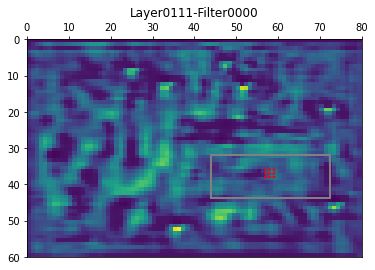

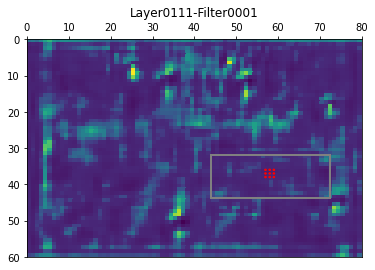

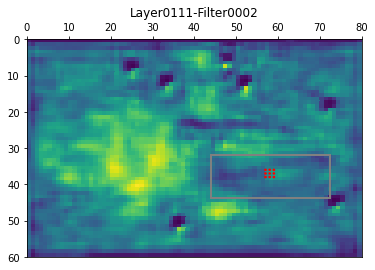

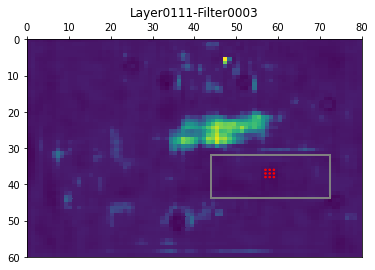

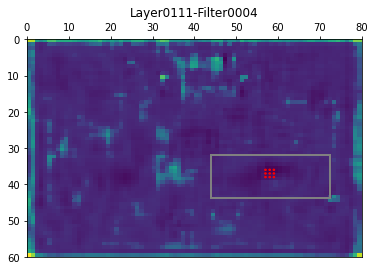

...

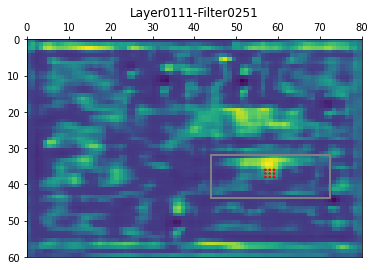

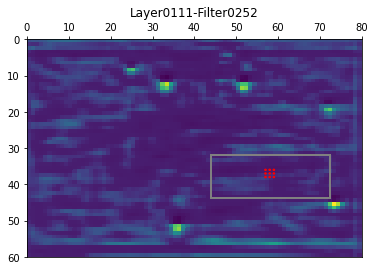

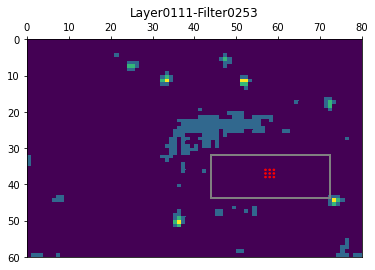

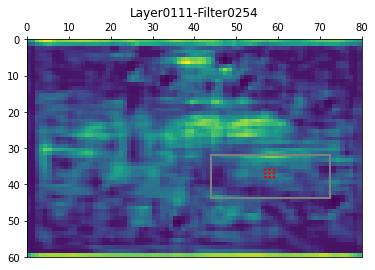

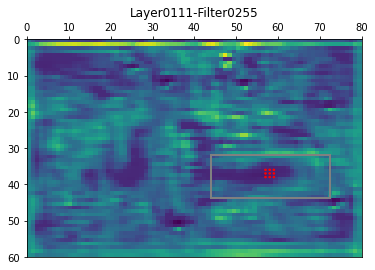

In [57]:
m_ImageInformation2=ImageInformation("E58_20210201_1057_000577.jpg")
m_ImageInformation2.ReadFeatureData(LAYER_INDEX)
m_ImageInformation2.GetCenterFeatureCell(m_ImageInformation2.BoxList[0],LAYER_INDEX)
#m_ImageInformation.GetBoxFeature(m_ImageInformation.BoxList[0],LAYER_INDEX)
m_ImageInformation2.ShowImage()
m_ImageInformation2.ShowFeatureMap(LAYER_INDEX)

In [62]:
m_FindPersistanceFeature_E58 = FindPersistanceFeature()
m_FindPersistanceFeature_E58.Run([577,584],strCarName="E58_20210201_1057_000")

Box(class,x,y,w,h): 0 275 -48 56 96  got problem in file  D:\dev\darknet-master\build\darknet\x64\yolov3_spp\E58_20210201_1057\E58_20210201_1057_000580.txt
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
Feature size: (3, 3, 256)
Feature size after combine: (256,)
[i].Smallest Feature idx,cnt 128:
147,144,220,166,40,253,119,213,224,25,101,128,121,103,115,60,22,159,10,78,63,120,79,214,14,210,218,47,70,36,123,31,43,203,172,20,206,1,236,146,90,228,200,222,129,3,44,211,64,145,56,180,4,160,82,66,243,107,132,171,33,86,114,77,175,117,74,201,242,24,202,133,162,235,29,80,240,155,21,68,28,238,226,94,199,88,134,11,62,83,221,32,232,255,194,8,148,42,112,252,73,71,241,5,197,183,182,223,156,245,130,109,179,248,143,229,169,104,136,181,208,27,151,198

In [63]:
m_FindPersistanceFeature_E58.TestIndex(CommonIndex,"Common index")

[i].Center feature error between frame 577 and frame 578 consecutive frame using Common index: 1.9732
[i].Center feature error between frame 578 and frame 579 consecutive frame using Common index: 2.6113999999999997
[i].Center feature error between frame 579 and frame 580 consecutive frame using Common index: 5.3841
[i].Center feature error between frame 580 and frame 581 consecutive frame using Common index: 4.3004
[i].Center feature error between frame 581 and frame 582 consecutive frame using Common index: 4.3694
[i].Center feature error between frame 582 and frame 583 consecutive frame using Common index: 5.749099999999999


# Test case 4. One car appears in 2 cameras E58 and E59 using common index 71,86,183,235

In [96]:
m_CompareFeatureBetween2Cars_B58_B59 = CompareFeatureBetween2Cars()
#m_CompareFeatureBetween2Cars_B58_B59.GetCenterFeatureError_2Frames(    ["E58_20210201_1057_000557.jpg","E59_20210201_1057_000581.jpg"])
#m_CompareFeatureBetween2Cars_B58_B59.TestIndex(CommonIndex)
m_CompareFeatureBetween2Cars_B58_B59.Run_Multiple_Camera(FrameList1=[577,584],
                                                         carPreName1 = "E58_20210201_1057_000",
                                                         FrameList2=[581,588],carPreName2="E59_20210201_1057_000")
m_CompareFeatureBetween2Cars_B58_B59.TestIndex2Camera(CommonIndex,index_type="Common Index")
    

Box(class,x,y,w,h): 0 275 -48 56 96  got problem in file  D:\dev\darknet-master\build\darknet\x64\yolov3_spp\E58_20210201_1057\E58_20210201_1057_000580.txt
[i].Feature error in camE58, frame 577 between box (cx:465,cy:303,w:228,h:96)  and box in camE59, frame 581(cx:198,cy:296,w:240,h:104) using Common Index: 8.271700000000001
[i].Feature error in camE58, frame 578 between box (cx:198,cy:296,w:240,h:104)  and box in camE59, frame 582(cx:497,cy:303,w:210,h:98) using Common Index: 9.323599999999999
[i].Feature error in camE58, frame 579 between box (cx:497,cy:303,w:210,h:98)  and box in camE59, frame 583(cx:244,cy:297,w:258,h:108) using Common Index: 8.374600000000001
[i].Feature error in camE58, frame 580 between box (cx:244,cy:297,w:258,h:108)  and box in camE59, frame 584(cx:524,cy:294,w:198,h:90) using Common Index: 14.0381
[i].Feature error in camE58, frame 581 between box (cx:524,cy:294,w:198,h:90)  and box in camE59, frame 585(cx:304,cy:300,w:272,h:108) using Common Index: 12.7320

# Test case 5. Compare 2 parked cars

In [107]:
m_CompareFeatureBetween2ParkedCars = CompareFeatureBetween2Cars()
#test only parked cars
m_CompareFeatureBetween2ParkedCars.Run([6872,6882],interesting_class = 1)

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size a

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size a

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size a

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size a

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size a

In [108]:
m_CompareFeatureBetween2ParkedCars.TestIndex(CommonIndex,index_type="Common Index",interesting_class = 1)

[i].Feature error in frame 6872 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:1,cx:583,cy:405,w:113,h:123) using Common Index: 27.8691
[i].Feature error in frame 6872 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:2,cx:85,cy:388,w:107,h:109) using Common Index: 31.7011
[i].Feature error in frame 6872 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:3,cx:376,cy:400,w:82,h:113) using Common Index: 32.422799999999995
[i].Feature error in frame 6872 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:4,cx:462,cy:395,w:91,h:109) using Common Index: 26.6158
[i].Feature error in frame 6872 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:5,cx:44,cy:118,w:91,h:93) using Common Index: 23.3708
[i].Feature error in frame 6872 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:6,cx:475,cy:93,w:112,h:113) using Common Index: 34.125299999999996
[i].Feature error in frame 6872 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:7,cx:379,cy:94,w:80,h:116) 

[i].Feature error in frame 6874 between box (ID:6,cx:44,cy:118,w:91,h:93)  and box(ID:7,cx:380,cy:97,w:80,h:119) using Common Index: 12.5695
[i].Feature error in frame 6875 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:1,cx:583,cy:405,w:113,h:123) using Common Index: 27.799599999999998
[i].Feature error in frame 6875 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:2,cx:85,cy:389,w:107,h:109) using Common Index: 31.9919
[i].Feature error in frame 6875 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:3,cx:376,cy:400,w:82,h:114) using Common Index: 32.3197
[i].Feature error in frame 6875 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:4,cx:462,cy:395,w:91,h:109) using Common Index: 26.540200000000002
[i].Feature error in frame 6875 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:5,cx:44,cy:118,w:91,h:93) using Common Index: 23.437400000000004
[i].Feature error in frame 6875 between box (ID:0,cx:276,cy:390,w:73,h:104)  and box(ID:6,cx:475,cy:93,w:11

[i].Feature error in frame 6878 between box (ID:1,cx:583,cy:405,w:113,h:123)  and box(ID:4,cx:462,cy:395,w:91,h:109) using Common Index: 5.239
[i].Feature error in frame 6878 between box (ID:1,cx:583,cy:405,w:113,h:123)  and box(ID:5,cx:475,cy:93,w:112,h:113) using Common Index: 9.6286
[i].Feature error in frame 6878 between box (ID:1,cx:583,cy:405,w:113,h:123)  and box(ID:6,cx:44,cy:118,w:91,h:93) using Common Index: 10.8249
[i].Feature error in frame 6878 between box (ID:1,cx:583,cy:405,w:113,h:123)  and box(ID:7,cx:379,cy:94,w:80,h:117) using Common Index: 7.4959
[i].Feature error in frame 6878 between box (ID:2,cx:85,cy:389,w:107,h:110)  and box(ID:3,cx:376,cy:400,w:82,h:114) using Common Index: 4.4559999999999995
[i].Feature error in frame 6878 between box (ID:2,cx:85,cy:389,w:107,h:110)  and box(ID:4,cx:462,cy:395,w:91,h:109) using Common Index: 8.6845
[i].Feature error in frame 6878 between box (ID:2,cx:85,cy:389,w:107,h:110)  and box(ID:5,cx:475,cy:93,w:112,h:113) using Common 

# Test case 6. Compare park vs move

<ipython-input-31-7d199beac502>:73: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots()


Feature map size: (60, 80) ;Center size: 3 3


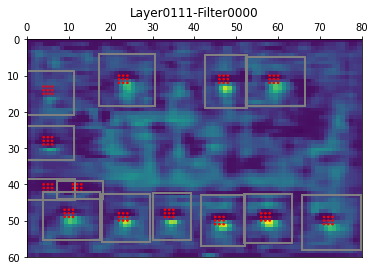

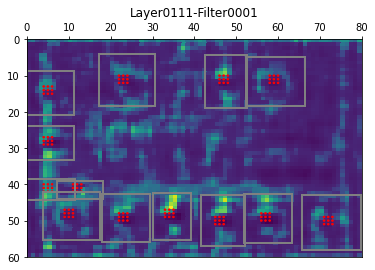

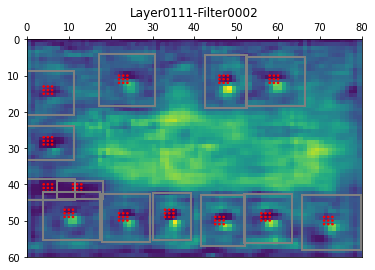

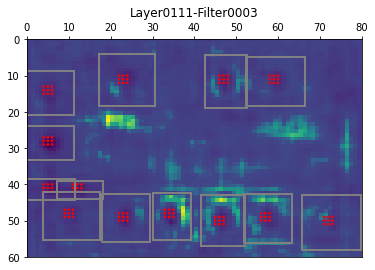

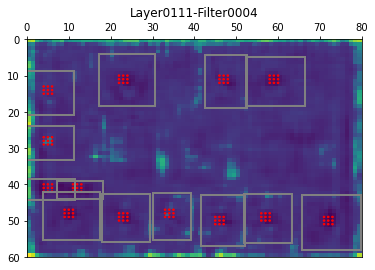

...

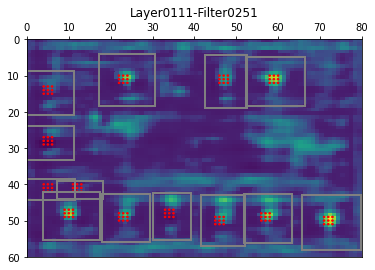

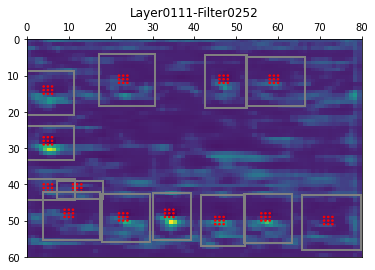

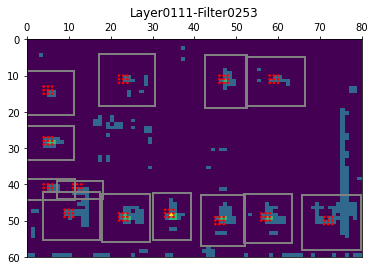

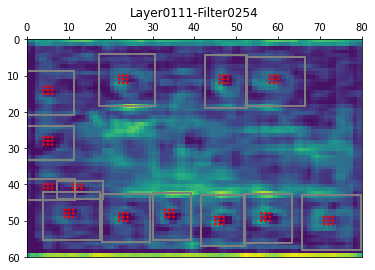

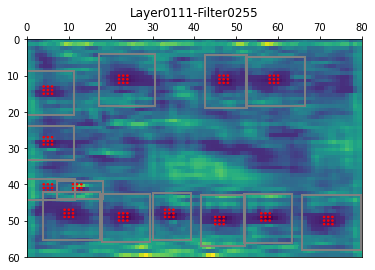

In [132]:
m_ImageInformation2=ImageInformation("D35_20210304_007220.jpg")
m_ImageInformation2.ReadFeatureData(LAYER_INDEX)
m_ImageInformation2.GetCenterFeatureCell(m_ImageInformation2.BoxList[0],LAYER_INDEX)
#m_ImageInformation.GetBoxFeature(m_ImageInformation.BoxList[0],LAYER_INDEX)
m_ImageInformation2.ShowImage()
m_ImageInformation2.ShowFeatureMap(LAYER_INDEX)

In [130]:
m_CompareFeatureBetween2CarType = CompareFeatureBetween2Cars()
#test only parked cars
m_CompareFeatureBetween2CarType.Run([7220,7258],interesting_class = 1,compare_diff_type = True)

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size a

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,221,117,39,112,24,165,209,97,228,237,15,6,187,244,132,30,164,1

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,221,117,112,24,39,165,97,209,228,15,140,163,244,249,6,164,233,132,184,0,93,84,19,30,187,34,116,227,69,222,41,106,188,205,178,141,170,55,251,54,95,195,102,207,118,173,53,113,167,192,196,76,122,65,152,135,85,126,142,174,23,168,137,61,9,72,111,216,208,237,13,183,138,186,2,136,16,91,194,109,125,193,182,127,59,58,250,68,57,161,100,51,37,110,219,154,94,26,87,230,7,17,92,143,190,108,12,35,239,247,246,99,74,223,191,235,241,234

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,221,39,117,165,112,24,15,209,97,228,6,93,244,140,0,233,132,69,41,164,163,187,55,227,84,51,249,222,30,34,126,19,188,136,106,116,195,205,118,250,251,65,58,113,122,53,178,54,137,23,170,95,196,76,207,190,102,16,230,141,173,85,111,192,208,167,237,100,125,193,72,9,174,57,216,37,2,108,152,194,52,94,139,183,142,13,168,184,67,254,99,138,127,234,186,61,68,240,109,110,182,59,91,176,35,156,45,219,135,161,154,201,235,87,89,92,7,26,241,239,50,17,198,247,124,12,231,[i].Max center feature error in frame 7235 between box (ID:10,cx:190,cy:90,w:107,h:114)  and box(ID:11,cx:371,cy:219,w:301,h:103): 585.4041
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,221,39,165,117,112,24,15,209,228,244,30,97,93,0,6,140,233,132,84,249,55,227,69,187,188,164,205,222,34,19,118,95,23,116,41,195,53,106,51,170,122,163,174,126,216,178,2,251,173,85,65,196,192,9,142,76,102,94,58,237,136,54,208,207,99,250,152,16,167,113,57,138,190,137,72,186,111,168,194,135,108,110,183,91,35,68,230,154,52,7,61,59,184,141,37,254,234,219,13,127,38,161,193,100,87,26,182,239,50,201,89,109,49,246,189,247,92,12,231,45,131,198,241,17,125,225,98,[i].Max center feature error in frame 7240 between box (ID:11,cx:486,cy:222,w:290,h:110)  and box(ID:12,cx:191,cy:90,w:109,h:115): 1253.4027
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature 

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,221,39,117,112,24,165,209,97,228,15,244,233,30,0,6,132,106,113,227,93,41,187,140,34,205,164,249,222,69,178,126,170,163,53,141,116,95,251,102,188,9,84,196,174,118,192,54,23,207,76,152,109,122,167,195,184,142,137,111,65,194,58,250,168,125,2,127,85,94,173,183,16,61,19,55,219,237,57,37,91,92,59,13,100,186,50,135,247,99,246,72,234,110,154,182,138,239,35,87,190,193,223,201,68,45,216,150,230,208,98,12,143,89,51,105,48,7,191,7

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,221,39,117,112,24,165,228,97,209,15,6,233,132,106,41,93,244,0,227,164,69,30,249,222,187,113,205,141,170,102,54,178,137,84,116,126,76,251,142,23,140,122,95,53,118,207,188,174,168,167,65,195,85,34,163,192,111,196,183,184,250,19,127,109,138,152,61,16,58,173,2,57,37,91,182,186,9,219,87,55,13,237,110,223,5

Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
Feature size: (3, 3, 256)
Feature size after combine (256,)
[i].Largest Feature idx,cnt[128]:
204,221,39,117,112,24,165,228,209,97,6,0,15,233,132,244,227,93,164,41,30,141,106,222,249,170,205,187,102,53,54,113,69,95,126,196,188,195,116,84,140,163,137,251,118,167,178,34,76,168,192,65,122,58,23,85,111,16,174,173,207,152,142,250,9,37,13,55,100,2,184,237,94,110,127,19,183,61,57,138,219,182,186,109,59,239,234,208,87,193,143,201,91,216,194,92,89,154,223,246,99,135,74,68,230,190,247,235,150,72,125,124,108,191,225,50,7,35,4

In [131]:
m_CompareFeatureBetween2CarType.TestIndex(CommonIndex,index_type="Common Index",interesting_class = 1,compare_diff_type = True)

[i].Feature error in frame 7220 between box (ID:2,cx:375,cy:400,w:84,h:112)  and box(ID:9,cx:44,cy:229,w:91,h:76) using Common Index: 14.7528
[i].Feature error in frame 7220 between box (ID:2,cx:375,cy:400,w:84,h:112)  and box(ID:12,cx:191,cy:90,w:107,h:114) using Common Index: 8.9496
[i].Feature error in frame 7220 between box (ID:3,cx:461,cy:395,w:91,h:108)  and box(ID:9,cx:44,cy:229,w:91,h:76) using Common Index: 12.6113
[i].Feature error in frame 7220 between box (ID:3,cx:461,cy:395,w:91,h:108)  and box(ID:12,cx:191,cy:90,w:107,h:114) using Common Index: 7.476699999999999
[i].Feature error in frame 7220 between box (ID:4,cx:475,cy:93,w:113,h:110)  and box(ID:9,cx:44,cy:229,w:91,h:76) using Common Index: 4.9283
[i].Feature error in frame 7220 between box (ID:4,cx:475,cy:93,w:113,h:110)  and box(ID:12,cx:191,cy:90,w:107,h:114) using Common Index: 4.1715
[i].Feature error in frame 7220 between box (ID:5,cx:380,cy:94,w:80,h:117)  and box(ID:9,cx:44,cy:229,w:91,h:76) using Common Index:

[i].Feature error in frame 7230 between box (ID:1,cx:277,cy:391,w:74,h:103)  and box(ID:9,cx:190,cy:90,w:109,h:114) using Common Index: 24.1777
[i].Feature error in frame 7230 between box (ID:1,cx:277,cy:391,w:74,h:103)  and box(ID:10,cx:199,cy:221,w:297,h:104) using Common Index: 27.8399
[i].Feature error in frame 7230 between box (ID:2,cx:474,cy:92,w:112,h:111)  and box(ID:9,cx:190,cy:90,w:109,h:114) using Common Index: 3.6933
[i].Feature error in frame 7230 between box (ID:2,cx:474,cy:92,w:112,h:111)  and box(ID:10,cx:199,cy:221,w:297,h:104) using Common Index: 9.9321
[i].Feature error in frame 7230 between box (ID:3,cx:375,cy:398,w:84,h:112)  and box(ID:9,cx:190,cy:90,w:109,h:114) using Common Index: 7.380699999999999
[i].Feature error in frame 7230 between box (ID:3,cx:375,cy:398,w:84,h:112)  and box(ID:10,cx:199,cy:221,w:297,h:104) using Common Index: 12.4953
[i].Feature error in frame 7230 between box (ID:4,cx:85,cy:390,w:109,h:106)  and box(ID:9,cx:190,cy:90,w:109,h:114) using 

[i].Feature error in frame 7240 between box (ID:8,cx:45,cy:119,w:90,h:98)  and box(ID:11,cx:486,cy:222,w:290,h:110) using Common Index: 11.9786
[i].Feature error in frame 7240 between box (ID:8,cx:45,cy:119,w:90,h:98)  and box(ID:12,cx:191,cy:90,w:109,h:115) using Common Index: 7.4736
[i].Feature error in frame 7240 between box (ID:9,cx:582,cy:404,w:114,h:122)  and box(ID:11,cx:486,cy:222,w:290,h:110) using Common Index: 14.342799999999999
[i].Feature error in frame 7240 between box (ID:9,cx:582,cy:404,w:114,h:122)  and box(ID:12,cx:191,cy:90,w:109,h:115) using Common Index: 6.5966000000000005
[i].Feature error in frame 7240 between box (ID:10,cx:85,cy:389,w:108,h:108)  and box(ID:11,cx:486,cy:222,w:290,h:110) using Common Index: 13.2732
[i].Feature error in frame 7240 between box (ID:10,cx:85,cy:389,w:108,h:108)  and box(ID:12,cx:191,cy:90,w:109,h:115) using Common Index: 5.4696
[i].Feature error in frame 7241 between box (ID:2,cx:373,cy:398,w:82,h:112)  and box(ID:11,cx:194,cy:91,w:1

[i].Feature error in frame 7251 between box (ID:9,cx:190,cy:91,w:110,h:113)  and box(ID:11,cx:85,cy:388,w:106,h:109) using Common Index: 7.9287
[i].Feature error in frame 7251 between box (ID:10,cx:583,cy:404,w:113,h:123)  and box(ID:12,cx:541,cy:249,w:199,h:117) using Common Index: 10.234599999999999
[i].Feature error in frame 7251 between box (ID:11,cx:85,cy:388,w:106,h:109)  and box(ID:12,cx:541,cy:249,w:199,h:117) using Common Index: 11.261199999999999
[i].Feature error in frame 7252 between box (ID:1,cx:583,cy:404,w:113,h:123)  and box(ID:8,cx:194,cy:91,w:108,h:114) using Common Index: 10.4968
[i].Feature error in frame 7252 between box (ID:1,cx:583,cy:404,w:113,h:123)  and box(ID:10,cx:541,cy:249,w:197,h:117) using Common Index: 10.865
[i].Feature error in frame 7252 between box (ID:2,cx:277,cy:391,w:72,h:106)  and box(ID:8,cx:194,cy:91,w:108,h:114) using Common Index: 24.0674
[i].Feature error in frame 7252 between box (ID:2,cx:277,cy:391,w:72,h:106)  and box(ID:10,cx:541,cy:249

# Conclusion